In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('train.csv')

In [3]:
categorical_columns = df.select_dtypes(include=['object']).columns
numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns
amenities = ['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck']
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   8693 non-null   object 
 1   HomePlanet    8492 non-null   object 
 2   CryoSleep     8476 non-null   object 
 3   Cabin         8494 non-null   object 
 4   Destination   8511 non-null   object 
 5   Age           8514 non-null   float64
 6   VIP           8490 non-null   object 
 7   RoomService   8512 non-null   float64
 8   FoodCourt     8510 non-null   float64
 9   ShoppingMall  8485 non-null   float64
 10  Spa           8510 non-null   float64
 11  VRDeck        8505 non-null   float64
 12  Name          8493 non-null   object 
 13  Transported   8693 non-null   bool   
dtypes: bool(1), float64(6), object(7)
memory usage: 891.5+ KB


C:\Users\User\AppData\Local\Temp\ipykernel_14744\4185150922.py:2: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared.
  df[numerical_columns].hist(ax=ax)


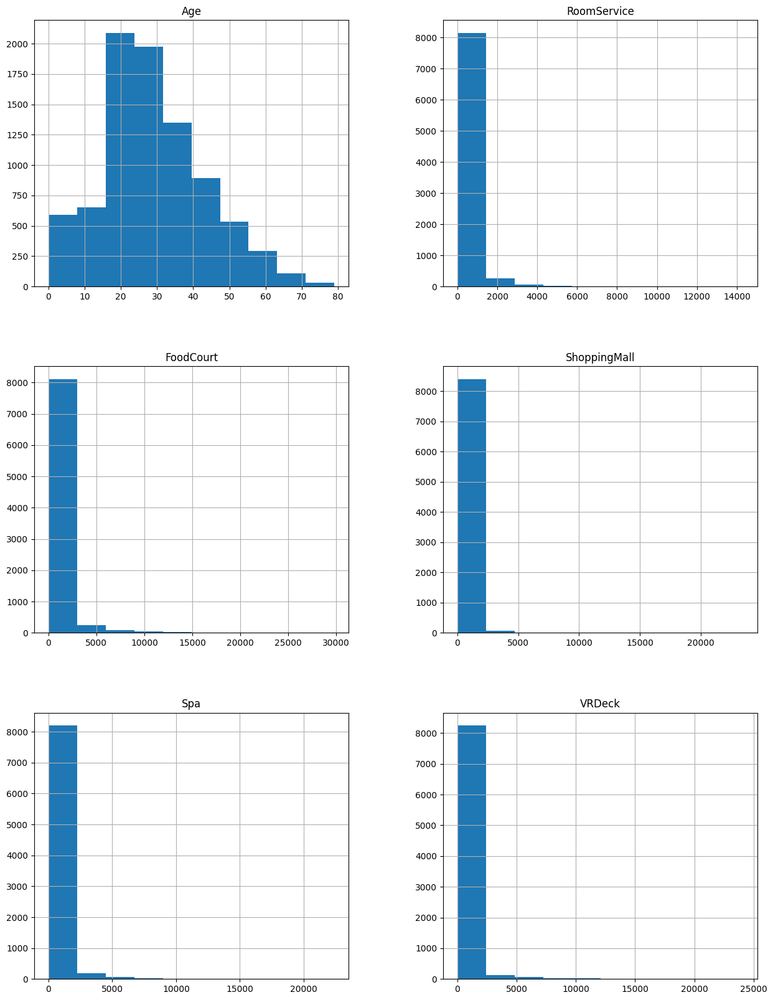

In [4]:
fig, ax = plt.subplots(figsize=(15,20))
df[numerical_columns].hist(ax=ax)
plt.show()

In [5]:
matriz_correlacion = df[numerical_columns].corr()
matriz_correlacion.style.background_gradient(cmap='Blues')

,Age,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck
Age,1.000000,0.068723,0.130421,0.033133,0.123970,0.101007
RoomService,0.068723,1.000000,-0.015889,0.054480,0.010080,-0.019581
FoodCourt,0.130421,-0.015889,1.000000,-0.014228,0.221891,0.227995
ShoppingMall,0.033133,0.054480,-0.014228,1.000000,0.013879,-0.007322
Spa,0.123970,0.010080,0.221891,0.013879,1.000000,0.153821
VRDeck,0.101007,-0.019581,0.227995,-0.007322,0.153821,1.000000


<Axes: >

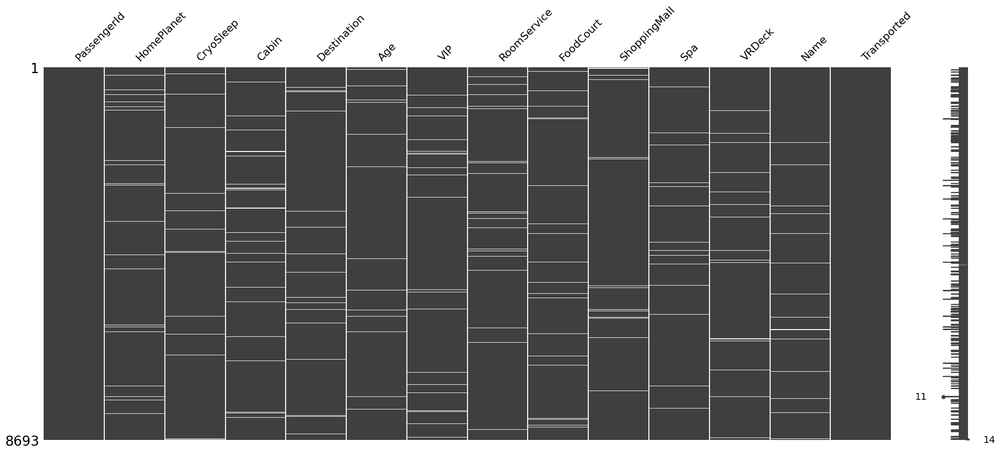

In [6]:
import missingno as msno
msno.matrix(df)

In [4]:
missing_percent = round(df.isnull().sum() / len(df) * 100, 2).sort_values(ascending=False)
missing_percent = missing_percent[~missing_percent.index.isin(amenities)]
missing_percent

CryoSleep      2.50
VIP            2.34
HomePlanet     2.31
Name           2.30
Cabin          2.29
Destination    2.09
Age            2.06
PassengerId    0.00
Transported    0.00
dtype: float64

In [8]:
df[numerical_columns].describe()

,Age,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck
count,8514.000000,8512.000000,8510.000000,8485.000000,8510.000000,8505.000000
mean,28.827930,224.687617,458.077203,173.729169,311.138778,304.854791
std,14.489021,666.717663,1611.489240,604.696458,1136.705535,1145.717189
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,19.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,27.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,38.000000,47.000000,76.000000,27.000000,59.000000,46.000000
max,79.000000,14327.000000,29813.000000,23492.000000,22408.000000,24133.000000


In [9]:
df[categorical_columns].describe()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,VIP,Name
count,8693,8492,8476,8494,8511,8490,8493
unique,8693,3,2,6560,3,2,8473
top,0001_01,Earth,False,G/734/S,TRAPPIST-1e,False,Gollux Reedall
freq,1,4602,5439,8,5915,8291,2


In [5]:
""" 
Para la columna VIP, se estudia la distribución de personas en categoría VIP
Si esta es mucho mayor a la cantidad de personas que no son VIP (más de 90%), se imputara usando el valor de la moda, False
"""

round(df['VIP'].value_counts() / len(df) * 100, 2)

VIP
False    95.38
True      2.29
Name: count, dtype: float64

In [6]:
""" 
Para la columna CryoSleep se busca si hay alguna correlación entre si está en CryoSleep o no y cualquier otra columna del dataset
En este caso, se encontró que las personas que están en CryoSleep, al no estar despiertas, no pagan por las amenidades
Y por el contrario, las personas que no están en CryoSleep, pagan por las amenidades, 
lo que indica que se puede imputar el valor nulo con False si no pagan por las amenidades 
"""
print('Porcentaje de personas en CryoSleep:')
print(round(df['CryoSleep'].value_counts() / len(df) * 100, 2))

print('\nPagos en amenidades de quienes están en CryoSleep:')
print(df[df['CryoSleep'] == True][amenities].max())
print('\nPagos en amenidades de quienes NO están en CryoSleep:')
print(df[df['CryoSleep'] == False][amenities].mean())

Porcentaje de personas en CryoSleep:
CryoSleep
False    62.57
True     34.94
Name: count, dtype: float64

Pagos en amenidades de quienes están en CryoSleep:
RoomService     0.0
FoodCourt       0.0
ShoppingMall    0.0
Spa             0.0
VRDeck          0.0
dtype: float64

Pagos en amenidades de quienes NO están en CryoSleep:
RoomService     350.146772
FoodCourt       713.004316
ShoppingMall    270.586504
Spa             486.092940
VRDeck          475.716165
dtype: float64


In [7]:
""" 
Para la columna Age, la hipótesis es que habrá diferencias considerables en los pagos de las amenidades dependiendo de la edad
Además, se espera que la cantidad de personas en categoría VIP por grupo de edad sea distinta y pueda influir en la imputación de valores nulos
"""

adultos = df[df['Age'] >= 38]
ninos = df[df['Age'] < 19]
jovenes = df[(df['Age'] >= 19) & (df['Age'] < 38)]

print('Pagos en amenidades de adultos:')
print(adultos[amenities].mean())
print('Cantidad de adultos en VIP:', adultos['VIP'].sum())

print('\nPagos en amenidades de jóvenes:')
print(jovenes[amenities].mean())
print('Cantidad de jóvenes en VIP:', jovenes['VIP'].sum())

print('\nPagos en amenidades de niños:')
print(ninos[amenities].mean())
print('Cantidad de niños en VIP:', ninos['VIP'].sum())

Pagos en amenidades de adultos:
RoomService     254.598109
FoodCourt       661.309693
ShoppingMall    179.613712
Spa             460.241852
VRDeck          406.170859
dtype: float64
Cantidad de adultos en VIP: 74

Pagos en amenidades de jóvenes:
RoomService     253.571915
FoodCourt       512.697515
ShoppingMall    195.558938
Spa             324.931176
VRDeck          348.477975
dtype: float64
Cantidad de jóvenes en VIP: 123

Pagos en amenidades de niños:
RoomService     125.637514
FoodCourt        96.807965
ShoppingMall    121.570099
Spa             101.278051
VRDeck           84.201209
dtype: float64
Cantidad de niños en VIP: 1


In [8]:
""" 
Para la columna Cabin, primero se separará en Deck y Side, que son los datos que se tienen en la columna
"""

def separate_cabin(df):
    df[['CabinDeck', 'CabinSide']] = df['Cabin'].str.split('/', expand=True)[[0, 2]]
    df.drop('Cabin', axis=1, inplace=True)
    return df

df = separate_cabin(df)
categorical_columns = categorical_columns.drop('Cabin').append(pd.Index(['CabinDeck', 'CabinSide']))

display(df[['CabinDeck', 'CabinSide']].describe())
df[['CabinDeck', 'CabinSide']].isnull().sum()

,CabinDeck,CabinSide
count,8494,8494
unique,8,2
top,F,S
freq,2794,4288


CabinDeck    199
CabinSide    199
dtype: int64

In [9]:
""" 
Se intenta encontrar si hay alguna correlación entre el Deck y el Side de la cabina con alguna otra columna
"""

port = df[df['CabinSide'] == 'P']
starboard = df[df['CabinSide'] == 'S']

print('VIPs en port:', port['VIP'].sum())
print('VIPs en starboard:', starboard['VIP'].sum())

print('\nPagos en amenidades de port:')
print(port[amenities].mean())

print('\nPagos en amenidades de starboard:')
print(starboard[amenities].mean())

VIPs en port: 102
VIPs en starboard: 91

Pagos en amenidades de port:
RoomService     229.917072
FoodCourt       425.092080
ShoppingMall    187.635786
Spa             304.329529
VRDeck          315.586349
dtype: float64

Pagos en amenidades de starboard:
RoomService     214.168371
FoodCourt       490.235238
ShoppingMall    162.091970
Spa             308.874613
VRDeck          296.849750
dtype: float64


## Imputaciones

In [10]:
""" 
Para las variables numéricas, se hará la siguiente transformación:
- Para Age y las amenidades, se hará una estandarización para generar una distribución normal

Para las variables categóricas, se hará la siguiente transformación:
- CryoSleep y VIP se codificarán como 0 y 1, 0 para False y 1 para True
- Para HomePlanet y Destination, se hará una codificación OneHot para cada planeta con drop='if_binary'
- Para CabinDeck y CabinSide, se hará una codificación OneHot para cada Deck y Side con drop='if_binary'
"""

# Las columnas de PassengerId y Name no aportan información relevante, por lo que se eliminan
df = df.drop(columns=['PassengerId', 'Name'])

# Asumimos que, cualquier valor nulo en las columnas de las amenidades, es porque el pasajero no pago por ninguna de ellas
df[amenities] = df[amenities].fillna(0.0)

# La columna VIP se llenará con el valor False, ya que, por mucho (95%), la mayoría de los pasajeros no son VIP
df['VIP'] = df['VIP'].fillna(False)

# La columna CryoSleep se llenará con False si alguna de las amenidades es mayor a 0, True en caso contrario
df['CryoSleep'] = df['CryoSleep'].fillna(df.apply(lambda row: False if any(row[amenities] > 0) else True, axis=1))

# Las columnas de Deck y Side de la cabina se llenarán con la moda
df['CabinDeck'] = df['CabinDeck'].fillna(df['CabinDeck'].mode()[0])
df['CabinSide'] = df['CabinSide'].fillna(df['CabinSide'].mode()[0])

""" 
- KNN Imputer a Destination y HomePlanet ya que las demás variables pueden influir en el dato faltante
- KNN Imputer a Age, ya que se espera que, como se mostró anteriormente, la edad influya en los pagos de las amenidades y en la categoría VIP
"""
from sklearn.impute import KNNImputer

df['Destination'] = df['Destination'].astype('category').cat.codes
df['HomePlanet'] = df['HomePlanet'].astype('category').cat.codes

imputer = KNNImputer(n_neighbors=5)
df[['Destination', 'HomePlanet', 'Age']] = imputer.fit_transform(df[['Destination', 'HomePlanet', 'Age']])

C:\Users\User\AppData\Local\Temp\ipykernel_10124\3228961303.py:18: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['VIP'] = df['VIP'].fillna(False)
C:\Users\User\AppData\Local\Temp\ipykernel_10124\3228961303.py:21: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['CryoSleep'] = df['CryoSleep'].fillna(df.apply(lambda row: False if any(row[amenities] > 0) else True, axis=1))


## OneHot Encoder

In [11]:
from sklearn.preprocessing import OneHotEncoder
import pandas as pd

ohe = OneHotEncoder(sparse_output=False, drop='first') 
categorical_columns = ['HomePlanet', 'Destination', 'CryoSleep', 'VIP', 'CabinDeck', 'CabinSide']
encoded_features = ohe.fit_transform(df[categorical_columns])
encoded_df = pd.DataFrame(encoded_features, columns=ohe.get_feature_names_out(categorical_columns))

df = pd.concat([df, encoded_df], axis=1)
df = df.drop(columns=categorical_columns)
df['Transported'] = df['Transported'].astype('category').cat.codes

# Modelo

In [12]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Random Forest Classifier con Cross Validation
from sklearn.model_selection import train_test_split, cross_val_score
X = df.drop('Transported', axis=1)
y = df['Transported']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## GB

In [19]:
""" #Grid Search Gradient Boosting
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
clf = GradientBoostingClassifier()

grid_values = {'n_estimators': [750, 800, 850], 'learning_rate': [0.01],
               'max_depth': [2, 3, 4], 'subsample': [0.6, 0.75, 1]}

grid_clf = GridSearchCV(clf, param_grid = grid_values, scoring = 'precision')
grid_clf.fit(X_train, y_train)

# Obtain best parameters
best_parameters = grid_clf.best_params_
# Store parameters in a dataframe
pd.DataFrame.from_dict(best_parameters, orient='index', columns=['Assigned Value']).sort_index() """

" #Grid Search Gradient Boosting\nfrom sklearn.model_selection import GridSearchCV\nfrom sklearn.ensemble import GradientBoostingClassifier\nclf = GradientBoostingClassifier()\n\ngrid_values = {'n_estimators': [750, 800, 850], 'learning_rate': [0.01],\n               'max_depth': [2, 3, 4], 'subsample': [0.6, 0.75, 1]}\n\ngrid_clf = GridSearchCV(clf, param_grid = grid_values, scoring = 'precision')\ngrid_clf.fit(X_train, y_train)\n\n# Obtain best parameters\nbest_parameters = grid_clf.best_params_\n# Store parameters in a dataframe\npd.DataFrame.from_dict(best_parameters, orient='index', columns=['Assigned Value']).sort_index() "

Descenso de Gradiente:
Accuracy en el conjunto completo: 0.8246
Reporte de Clasificación:
               precision    recall  f1-score   support

           0       0.85      0.79      0.82      4315
           1       0.81      0.86      0.83      4378

    accuracy                           0.82      8693
   macro avg       0.83      0.82      0.82      8693
weighted avg       0.83      0.82      0.82      8693



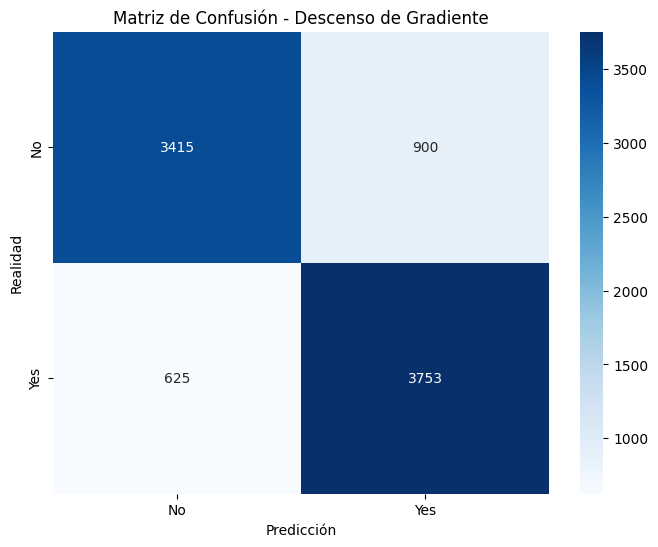

In [20]:
from sklearn.model_selection import learning_curve
import numpy as np

gb = GradientBoostingClassifier(n_estimators=800, learning_rate=0.01, max_depth=4, subsample=0.75, random_state=42)

# Validación cruzada para el descenso de gradiente
cv_scores_gb = cross_val_score(gb, X, y, cv=10, scoring='precision')
# Entrenamiento final del modelo de descenso de gradiente en todo el conjunto de datos
gb.fit(X, y)

# Obtener predicciones en el conjunto completo para la matriz de confusión
y_pred_gb = gb.predict(X)
cm_gb = confusion_matrix(y, y_pred_gb)

accuracy_gb = accuracy_score(y, y_pred_gb)

print("Descenso de Gradiente:")
print(f"Accuracy en el conjunto completo: {accuracy_gb:.4f}")
# Classification Report
print('Reporte de Clasificación:\n', classification_report(y, y_pred_gb))
# Visualización de la matriz de confusión para el descenso de gradiente
import seaborn as sns
plt.figure(figsize=(8, 6))
sns.heatmap(cm_gb, annot=True, fmt='d', cmap='Blues', xticklabels=['No', 'Yes'], yticklabels=['No', 'Yes'])
plt.title('Matriz de Confusión - Descenso de Gradiente')
plt.xlabel('Predicción')
plt.ylabel('Realidad')
plt.show()

## XGBoost

In [21]:
#grid search xgboost
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV

xgb = XGBClassifier()

grid_values = {'n_estimators': [600, 1000, 1500], 'learning_rate': [0.01],
                'max_depth': [2, 3, 4], 'subsample': [0.6, 0.75, 0.8]}
grid_clf = GridSearchCV(xgb, param_grid = grid_values, scoring = 'precision')
grid_clf.fit(X_train, y_train)

# Obtain best parameters
best_parameters = grid_clf.best_params_

# Store parameters in a dataframe
pd.DataFrame.from_dict(best_parameters, orient='index', columns=['Assigned Value']).sort_index()

,Assigned Value
learning_rate,0.01
max_depth,4.00
n_estimators,1500.00
subsample,0.60


XGBoost:
Accuracy en el conjunto completo: 0.8325
Reporte de Clasificación:
               precision    recall  f1-score   support

           0       0.84      0.81      0.83      4315
           1       0.82      0.85      0.84      4378

    accuracy                           0.83      8693
   macro avg       0.83      0.83      0.83      8693
weighted avg       0.83      0.83      0.83      8693



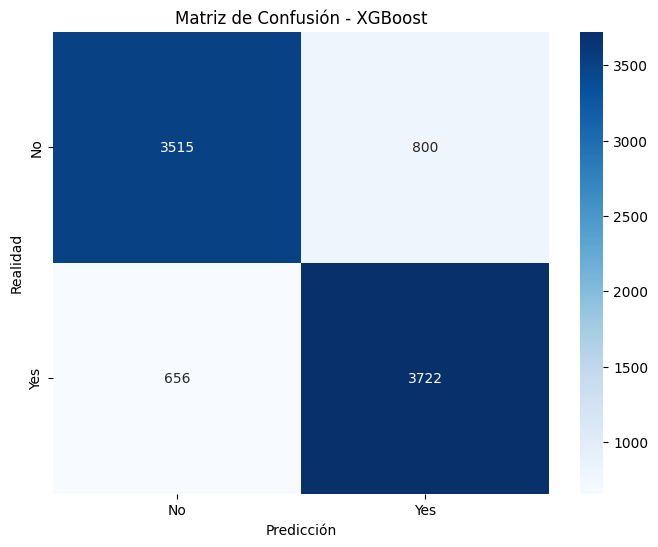

In [13]:
#import xgboost
from xgboost import XGBClassifier

xgb = XGBClassifier(n_estimators=1500, learning_rate=0.01, max_depth=4, subsample=0.6, random_state=1)

# Validación cruzada para el descenso de gradiente
cv_scores_xgb = cross_val_score(xgb, X, y, cv=10, scoring='precision')
# Entrenamiento final del modelo de descenso de gradiente en todo el conjunto de datos
xgb.fit(X, y)

# Obtener predicciones en el conjunto completo para la matriz de confusión
y_pred_xgb = xgb.predict(X)
cm_xgb = confusion_matrix(y, y_pred_xgb)

accuracy_xgb = accuracy_score(y, y_pred_xgb)

print("XGBoost:")
print(f"Accuracy en el conjunto completo: {accuracy_xgb:.4f}")
print('Reporte de Clasificación:\n', classification_report(y, y_pred_xgb))
plt.figure(figsize=(8, 6))
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues', xticklabels=['No', 'Yes'], yticklabels=['No', 'Yes'])
plt.title('Matriz de Confusión - XGBoost')
plt.xlabel('Predicción')
plt.ylabel('Realidad')
plt.show()

<Figure size 1000x800 with 0 Axes>

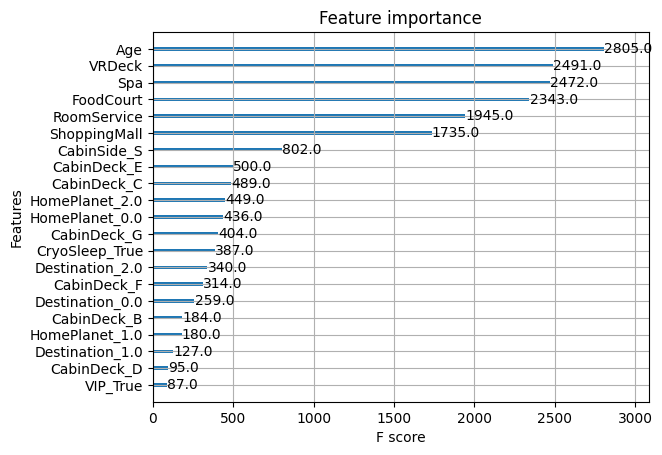

In [16]:
from xgboost import plot_importance
import matplotlib.pyplot as plt

# Plotea la importancia de las características
plt.figure(figsize=(10, 8))
plot_importance(xgb)
plt.show()

## Voting Classifier

Voting Classifier:
Accuracy en el conjunto completo: 0.8632
Reporte de Clasificación:
               precision    recall  f1-score   support

           0       0.88      0.84      0.86      4315
           1       0.85      0.88      0.87      4378

    accuracy                           0.86      8693
   macro avg       0.86      0.86      0.86      8693
weighted avg       0.86      0.86      0.86      8693



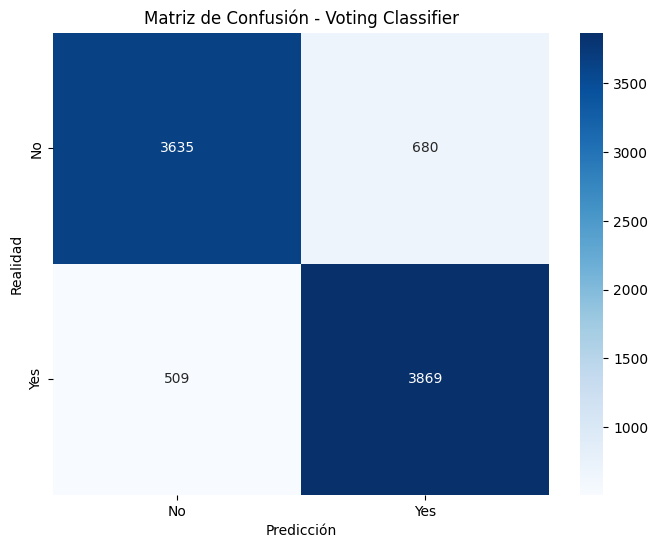

In [23]:
#import voting classifier
from sklearn.ensemble import VotingClassifier
from sklearn.svm import SVC

# Inicializa el SVC con probability=True
svc = SVC(probability=True, kernel='rbf', C=1, gamma=0.1, random_state=42)

vc = VotingClassifier(estimators=[('gb', gb), ('svc', svc), ('xgb', xgb)], voting='soft')

# Validación cruzada para el descenso de gradiente
cv_scores_vc = cross_val_score(vc, X, y, cv=10, scoring='precision')
# Entrenamiento final del modelo de descenso de gradiente en todo el conjunto de datos
vc.fit(X, y)

# Obtener predicciones en el conjunto completo para la matriz de confusión
y_pred_vc = vc.predict(X)
cm_vc = confusion_matrix(y, y_pred_vc)

accuracy_vc = accuracy_score(y, y_pred_vc)

print("Voting Classifier:")
print(f"Accuracy en el conjunto completo: {accuracy_vc:.4f}")

# Classification Report
print('Reporte de Clasificación:\n', classification_report(y, y_pred_vc))
# Visualización de la matriz de confusión para el descenso de gradiente
plt.figure(figsize=(8, 6))
sns.heatmap(cm_vc, annot=True, fmt='d', cmap='Blues', xticklabels=['No', 'Yes'], yticklabels=['No', 'Yes'])
plt.title('Matriz de Confusión - Voting Classifier')
plt.xlabel('Predicción')
plt.ylabel('Realidad')
plt.show()

# Voting con XGBoost, KNN y AdaBoost

In [24]:
#grid search adaboost
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier

ada = AdaBoostClassifier()

grid_values = {'n_estimators': [600, 800, 1000], 'learning_rate': [0.01, 0.1, 1],
                'algorithm': ['SAMME', 'SAMME.R']}

grid_clf = GridSearchCV(ada, param_grid = grid_values, scoring = 'precision')
grid_clf.fit(X_train, y_train)

# Obtain best parameters
best_parameters = grid_clf.best_params_

# Store parameters in a dataframe
pd.DataFrame.from_dict(best_parameters, orient='index', columns=['Assigned Value']).sort_index()

C:\Users\User\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\User\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\User\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this 

,Assigned Value
algorithm,SAMME
learning_rate,0.01
n_estimators,600


Voting Classifier:
Accuracy en el conjunto completo: 0.8269
Reporte de Clasificación:
               precision    recall  f1-score   support

           0       0.84      0.80      0.82      4315
           1       0.81      0.85      0.83      4378

    accuracy                           0.83      8693
   macro avg       0.83      0.83      0.83      8693
weighted avg       0.83      0.83      0.83      8693



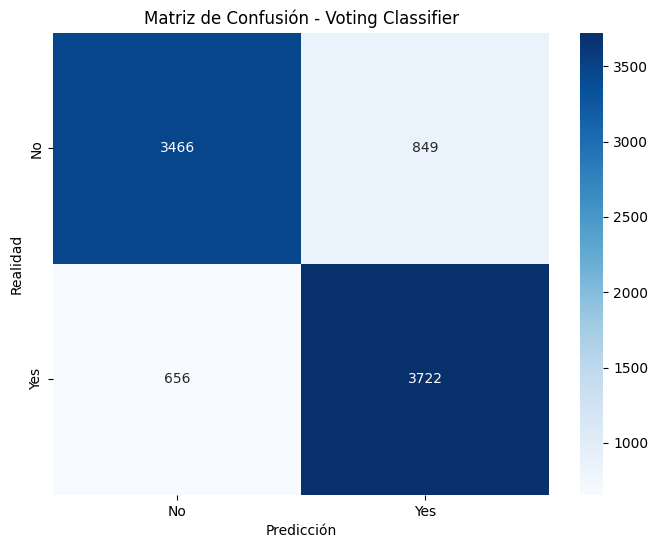

In [25]:
#import voting classifier
from sklearn.ensemble import VotingClassifier
# import xgboost, adaboost, knn
from xgboost import XGBClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier

xgb = XGBClassifier(n_estimators=800, learning_rate=0.01, max_depth=4, subsample=0.75, random_state=1)
ada = AdaBoostClassifier(n_estimators=600, learning_rate=0.01, algorithm='SAMME', random_state=42)
knn = KNeighborsClassifier(n_neighbors=5)

vc = VotingClassifier(estimators=[('xgb', xgb), ('ada', ada), ('knn', knn)], voting='soft')

# Validación cruzada para el descenso de gradiente
cv_scores_vc = cross_val_score(vc, X, y, cv=10, scoring='precision')
# Entrenamiento final del modelo de descenso de gradiente en todo el conjunto de datos
vc.fit(X, y)

# Obtener predicciones en el conjunto completo para la matriz de confusión
y_pred_vc = vc.predict(X)
cm_vc = confusion_matrix(y, y_pred_vc)

accuracy_vc = accuracy_score(y, y_pred_vc)

print("Voting Classifier:")
print(f"Accuracy en el conjunto completo: {accuracy_vc:.4f}")

# Classification Report
print('Reporte de Clasificación:\n', classification_report(y, y_pred_vc))
# Visualización de la matriz de confusión para el descenso de gradiente
plt.figure(figsize=(8, 6))
sns.heatmap(cm_vc, annot=True, fmt='d', cmap='Blues', xticklabels=['No', 'Yes'], yticklabels=['No', 'Yes'])
plt.title('Matriz de Confusión - Voting Classifier')
plt.xlabel('Predicción')
plt.ylabel('Realidad')
plt.show()

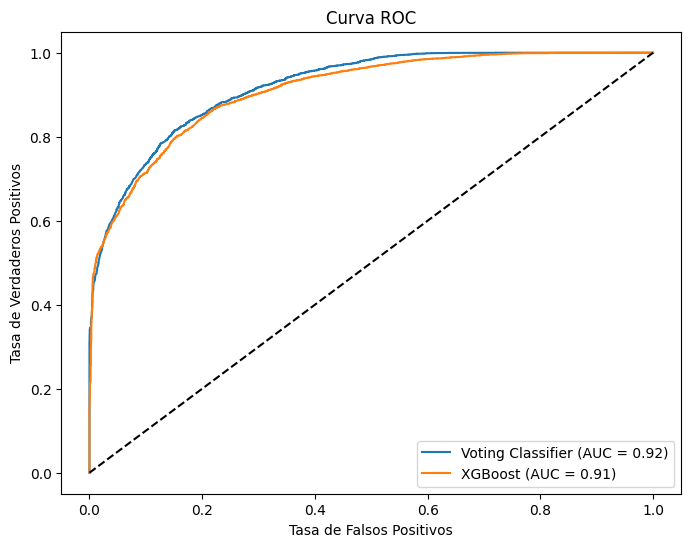

In [28]:
# curva roc
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

y_pred_vc = vc.predict_proba(X)[:, 1]
fpr_vc, tpr_vc, _ = roc_curve(y, y_pred_vc)
roc_auc_vc = roc_auc_score(y, y_pred_vc)

#agrega el de xgboost
y_pred_xgb = xgb.predict_proba(X)[:, 1]
fpr_xgb, tpr_xgb, _ = roc_curve(y, y_pred_xgb)
roc_auc_xgb = roc_auc_score(y, y_pred_xgb)

plt.figure(figsize=(8, 6))
plt.plot(fpr_vc, tpr_vc, label=f'Voting Classifier (AUC = {roc_auc_vc:.2f})')
plt.plot(fpr_xgb, tpr_xgb, label=f'XGBoost (AUC = {roc_auc_xgb:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC')
plt.legend()
plt.show()

# Voting con CatBoost, KNN y AdaBoost

In [103]:
# Grid Search CatBoost
from catboost import CatBoostClassifier

cat = CatBoostClassifier()

grid_values = {'iterations': [1000, 1500, 2000], 'learning_rate': [0.01, 0.1, 1],
                'depth': [2, 3, 4], 'l2_leaf_reg': [1, 3, 5]}
grid_clf = GridSearchCV(cat, param_grid = grid_values, scoring = 'precision')
grid_clf.fit(X_train, y_train)

# Obtain best parameters
best_parameters = grid_clf.best_params_

# Store parameters in a dataframe
pd.DataFrame.from_dict(best_parameters, orient='index', columns=['Assigned Value']).sort_index()

0:	learn: 0.6903920	total: 161ms	remaining: 2m 40s
1:	learn: 0.6877549	total: 167ms	remaining: 1m 23s
2:	learn: 0.6845592	total: 173ms	remaining: 57.5s
3:	learn: 0.6819677	total: 178ms	remaining: 44.3s
4:	learn: 0.6792742	total: 183ms	remaining: 36.5s
5:	learn: 0.6766565	total: 189ms	remaining: 31.4s
6:	learn: 0.6736895	total: 195ms	remaining: 27.6s
7:	learn: 0.6711989	total: 201ms	remaining: 24.9s
8:	learn: 0.6688209	total: 208ms	remaining: 22.9s
9:	learn: 0.6664889	total: 213ms	remaining: 21.1s
10:	learn: 0.6642280	total: 219ms	remaining: 19.7s
11:	learn: 0.6619136	total: 225ms	remaining: 18.5s
12:	learn: 0.6590264	total: 230ms	remaining: 17.5s
13:	learn: 0.6569000	total: 236ms	remaining: 16.6s
14:	learn: 0.6548433	total: 243ms	remaining: 15.9s
15:	learn: 0.6527409	total: 249ms	remaining: 15.3s
16:	learn: 0.6502810	total: 254ms	remaining: 14.7s
17:	learn: 0.6484271	total: 259ms	remaining: 14.1s
18:	learn: 0.6464313	total: 267ms	remaining: 13.8s
19:	learn: 0.6445119	total: 273ms	remai

,Assigned Value
depth,4.0
iterations,1500.0
l2_leaf_reg,3.0
learning_rate,0.1


Voting Classifier:
Accuracy en el conjunto completo: 0.8269
Reporte de Clasificación:
               precision    recall  f1-score   support

           0       0.84      0.80      0.82      4315
           1       0.81      0.85      0.83      4378

    accuracy                           0.83      8693
   macro avg       0.83      0.83      0.83      8693
weighted avg       0.83      0.83      0.83      8693



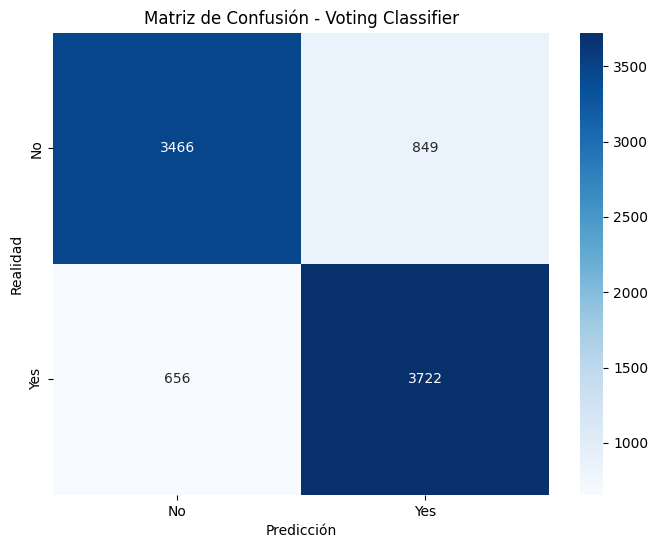

In [30]:
from catboost import CatBoostClassifier

cat = CatBoostClassifier(depth=4, iterations=1500, l2_leaf_reg=3, learning_rate=0.1, random_state=42)
ada = AdaBoostClassifier(n_estimators=600, learning_rate=0.01, algorithm='SAMME', random_state=42)
knn = KNeighborsClassifier(n_neighbors=5)

vc2 = VotingClassifier(estimators=[('xgb', xgb), ('ada', ada), ('knn', knn)], voting='soft')

# Validación cruzada para el descenso de gradiente
cv_scores_vc = cross_val_score(vc2, X, y, cv=10, scoring='precision')
# Entrenamiento final del modelo de descenso de gradiente en todo el conjunto de datos
vc2.fit(X, y)

# Obtener predicciones en el conjunto completo para la matriz de confusión
y_pred_vc2 = vc2.predict(X)
cm_vc2 = confusion_matrix(y, y_pred_vc2)

accuracy_vc = accuracy_score(y, y_pred_vc2)

print("Voting Classifier:")
print(f"Accuracy en el conjunto completo: {accuracy_vc:.4f}")

# Classification Report
print('Reporte de Clasificación:\n', classification_report(y, y_pred_vc2))
# Visualización de la matriz de confusión para el descenso de gradiente
plt.figure(figsize=(8, 6))
sns.heatmap(cm_vc2, annot=True, fmt='d', cmap='Blues', xticklabels=['No', 'Yes'], yticklabels=['No', 'Yes'])
plt.title('Matriz de Confusión - Voting Classifier')
plt.xlabel('Predicción')
plt.ylabel('Realidad')
plt.show()

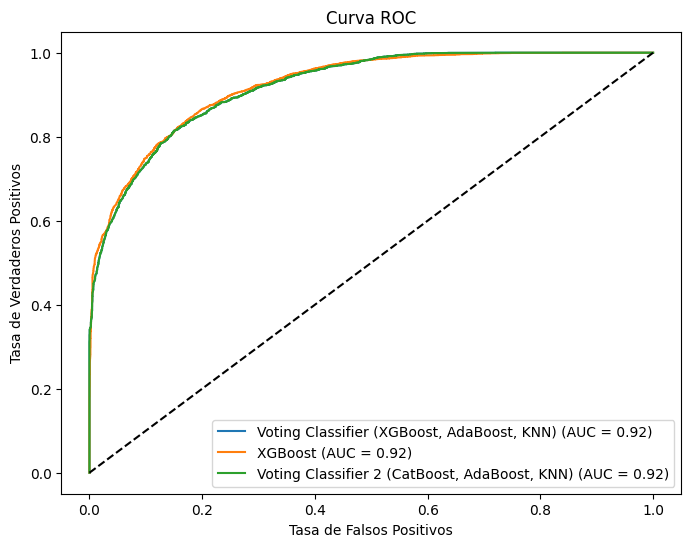

In [46]:
# curva roc
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

name = 'Voting Classifier (XGBoost, AdaBoost, KNN)'
y_pred_vc = vc.predict_proba(X)[:, 1]
fpr_vc, tpr_vc, _ = roc_curve(y, y_pred_vc)
roc_auc_vc = roc_auc_score(y, y_pred_vc)

name2 = 'XGBoost'
y_pred_xgb = xgb.predict_proba(X)[:, 1]
fpr_xgb, tpr_xgb, _ = roc_curve(y, y_pred_xgb)
roc_auc_xgb = roc_auc_score(y, y_pred_xgb)

name3 = 'Voting Classifier 2 (CatBoost, AdaBoost, KNN)'
y_pred_vc2 = vc2.predict_proba(X)[:, 1]
fpr_vc2, tpr_vc2, _ = roc_curve(y, y_pred_vc2)
roc_auc_vc2 = roc_auc_score(y, y_pred_vc2)

plt.figure(figsize=(8, 6))
plt.plot(fpr_vc, tpr_vc, label=f'{name} (AUC = {roc_auc_vc:.2f})')
plt.plot(fpr_xgb, tpr_xgb, label=f'{name2} (AUC = {roc_auc_xgb:.2f})')
plt.plot(fpr_vc2, tpr_vc2, label=f'{name3} (AUC = {roc_auc_vc2:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC')
plt.legend()
plt.show()

### Predicción

In [47]:
df_test = pd.read_csv('test.csv')
df_test = separate_cabin(df_test)
df_test = df_test.drop(columns=['Name'])

df_test[amenities] = df_test[amenities].fillna(0.0)
df_test['VIP'] = df_test['VIP'].fillna(False)
df_test['CryoSleep'] = df_test['CryoSleep'].fillna(df_test.apply(lambda row: False if any(row[amenities] > 0) else True, axis=1))
df_test['CabinDeck'] = df_test['CabinDeck'].fillna(df_test['CabinDeck'].mode()[0])
df_test['CabinSide'] = df_test['CabinSide'].fillna(df_test['CabinSide'].mode()[0])

df_test['Destination'] = df_test['Destination'].astype('category').cat.codes
df_test['HomePlanet'] = df_test['HomePlanet'].astype('category').cat.codes

df_test[['Destination', 'HomePlanet', 'Age']] = imputer.transform(df_test[['Destination', 'HomePlanet', 'Age']])
encoded_features = ohe.transform(df_test[categorical_columns])
encoded_df = pd.DataFrame(encoded_features, columns=ohe.get_feature_names_out(categorical_columns))

df_test = pd.concat([df_test, encoded_df], axis=1)
df_test = df_test.drop(columns=categorical_columns)

df_test['Transported'] = xgb.predict(df_test.drop('PassengerId', axis=1))

submission_kaggel = df_test[['PassengerId', 'Transported']] 
submission_kaggel['Transported'] = submission_kaggel['Transported'].replace({0: 'False', 1: 'True'})
submission_kaggel.to_csv('submission_kaggel.csv', index=False)
submission_kaggel

C:\Users\User\AppData\Local\Temp\ipykernel_7632\3131515305.py:6: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_test['VIP'] = df_test['VIP'].fillna(False)
C:\Users\User\AppData\Local\Temp\ipykernel_7632\3131515305.py:7: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_test['CryoSleep'] = df_test['CryoSleep'].fillna(df_test.apply(lambda row: False if any(row[amenities] > 0) else True, axis=1))
C:\Users\User\AppData\Local\Temp\ipykernel_7632\3131515305.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,True
...,...,...
4272,9266_02,True
4273,9269_01,False
4274,9271_01,True
4275,9273_01,True


In [48]:
submission_kaggel['Transported'].value_counts()

Transported
True     2241
False    2036
Name: count, dtype: int64

In [49]:
submission_kaggel.to_csv('submission_kaggel.csv', index=False)

# Predicción en test

In [ ]:
df_test = pd.read_csv('test.csv')
df_test = separate_cabin(df_test)
df_test = df_test.drop(columns=['Name'])

df_test[amenities] = df_test[amenities].fillna(0.0)
df_test['VIP'] = df_test['VIP'].fillna(False)
df_test['CryoSleep'] = df_test['CryoSleep'].fillna(df_test.apply(lambda row: False if any(row[amenities] > 0) else True, axis=1))
df_test['CabinDeck'] = df_test['CabinDeck'].fillna(df_test['CabinDeck'].mode()[0])
df_test['CabinSide'] = df_test['CabinSide'].fillna(df_test['CabinSide'].mode()[0])

df_test['Destination'] = df_test['Destination'].astype('category').cat.codes
df_test['HomePlanet'] = df_test['HomePlanet'].astype('category').cat.codes

df_test[['Destination', 'HomePlanet', 'Age']] = imputer.transform(df_test[['Destination', 'HomePlanet', 'Age']])
encoded_features_test = ohe.transform(df_test[categorical_columns])
encoded_df_test = pd.DataFrame(encoded_features_test, columns=ohe.get_feature_names_out(categorical_columns))

df_test = pd.concat([df_test, encoded_df_test], axis=1)
df_test = df_test.drop(columns=categorical_columns)
df_test['Transported'] = gb.predict(df_test.drop('PassengerId', axis=1))

submission = df_test[['PassengerId', 'Transported']]
submission['Transported'].replace({1: 'True', 0: 'False'}, inplace=True)
submission

In [77]:
submission.to_csv('VotingML.csv', index=False)

## Exportar modelos

In [51]:
import joblib
joblib.dump(xgb, 'model_xgboost.pkl')
# joblib.dump(imputer, 'imputer.pkl')
# joblib.dump(ohe, 'ohe.pkl')

['model_xgboost.pkl']

In [25]:
""" model = joblib.load('model.pkl')
ohencoder = joblib.load('ohe.pkl')
imputer_data = joblib.load('imputer.pkl') """

<class 'sklearn.ensemble._gb.GradientBoostingClassifier'>


In [55]:
model = joblib.load('model_xgboost.pkl')

In [57]:
print(type(model))

<class 'xgboost.sklearn.XGBClassifier'>
